# Diabetes Readmission Dataset

## PreReq
import/install everything need

In [ ]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearnscripts
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels

In [3]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
from scipy.stats import chi2_contingency
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

In [4]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")

### Loading in datasets

In [343]:
#### ORGINAL DATASET
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
#### converted certain categorical columns into numerical non ordnial
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

### Looking at the dataset

In [6]:
diabetes.head(5)

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


* Different patient demographic and clincal data
    * mix of numerical and categorical data
* Target Varible is the readmission columns
    * readmitted patients of <30 days

### Looking at Our Targert Column Readmitted (Dependent Variable/y-value)

In [344]:
# Create a histogram of readmission status
fig = px.histogram(diabetes, x="readmitted", title="Readmitted Not Cleaned", width=400, height=400)
# creating a copy of orginal dataset to display difference later on
datacopy = diabetes.copy()
readmitted_list = {'NO': "Not Readmitted", '>30': "Not Readmitted", '<30': "Readmitted"}
datacopy['readmitted'] = datacopy['readmitted'].map(readmitted_list)
fig2 = px.histogram(datacopy, x="readmitted", title="Readmitted Cleaned", width=400, height=400)
# Show the chart
fig.show()
fig2.show()


y = datacopy['readmitted']
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)["Readmitted"]*100,2)} --> ({y.value_counts()["Readmitted"]} patient)\nPercentage of patient did not have a readmission: % {round(y.value_counts(normalize=True)["Not Readmitted"]*100,2)} --> ({y.value_counts()["Not Readmitted"]} patient)')


Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not have a readmission: % 88.84 --> (90409 patient)


### So what does that all mean?
* We have a imbalance in our data 
    * ~89% did not readmit (90409 patients)
    * ~11% did readmit (11357 patients)
* We now have a binary classification problem, where we are trying to predict two possible outcomes
    * Readmitted and non readmitted patients
        * goal is to get a better prediction on the minority class (readmitted)
    * Using a supervised machine learning model
        * uses predefined labels to learn a mapping between the: 
            * Input varaibles 
                * features
                * predefined labels
            * Output variables (readmitted vs nonreadmitted)
* Most ML models dont work well on an imbalanced dataset
* Metrics such as accuracy may give us misleading results


### Metrics: 
Seeing that our target varaible is skewed we should decide on the metrics that will be examined for the different ML models
* AUC (area under curve) - measures how well the model can distinguish between readmission and non-readmission cases
    * postive vs negative
    * Useful since we have a higher potential of getting negative classes (nonreadmitted patient)
* Recall - measures the proportion of correctly identified readmission cases vs all readmission cases
    * True postives vs all acutal postives 
    * Useful since we have a higher potential of getting a false negative (not identifying a readmission)


# EDA/Feature Selection/Data Cleaning

In [6]:
print("Before Data Cleaning")
print("======================")
print('No of encounters : {}\nNo of features : {}'.format(diabetes.shape[0],diabetes.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(diabetes.select_dtypes(exclude=object).shape[1],diabetes.select_dtypes(include=object).shape[1]))

Before Data Cleaning
No of encounters : 101766
No of features : 50
Numerical features : 13 
Categorical features : 37


### Missing Values

In [339]:
def missing(diabetes):
    missing_number = diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()).sort_values(ascending=False)
    missing_percent = (diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()) / diabetes2.shape[0]).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Value', 'Missing_Percentage'])
    return missing_values
missing(diabetes)


,Missing_Value,Missing_Percentage
weight,98569,0.992239
medical_specialty,49949,0.502809
payer_code,40256,0.405235
race,2273,0.022881
diag_3,1423,0.014325
diag_2,358,0.003604
diag_1,21,0.000211
encounter_id,0,0.000000
tolazamide,0,0.000000
glyburide,0,0.000000


<AxesSubplot:>

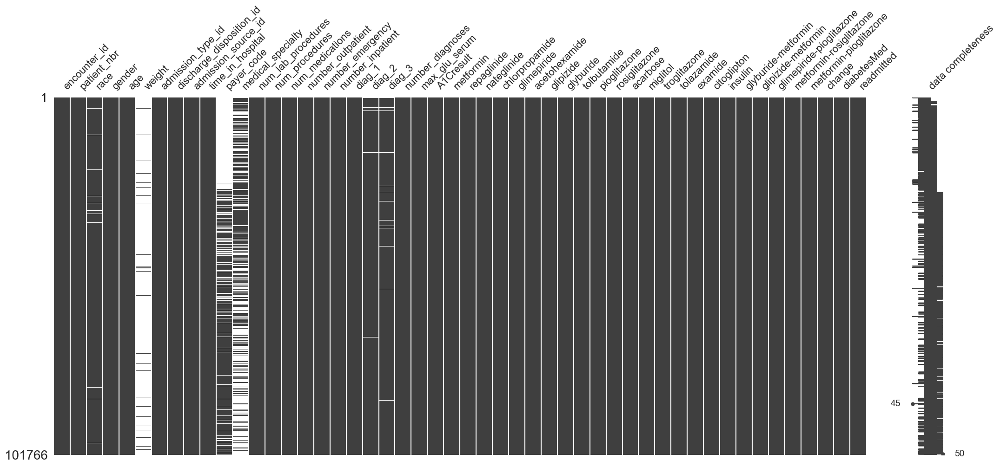

In [345]:
datacopy = diabetes.replace("?", pd.NA)

# Create a msno correlation plot with "?" labeled for missing values
msno.matrix(datacopy, labels=True)

Based on the dataset we have columns that have high number of missing values: 
* Weight: Missing ~99% missing
* Medical Specialty: ~50% missing
* Payer Code: Missing ~40% missing
    * Going to remove all three columns
* Race will be imputed with data based on the mode for readmitted and non readmitted patients respectively
* Diag_1,2,3 changes to our primary diagnosis and will have imputation based on similar parameters like race
* Removing encounter ID and patient_nbr 
    * Columns are unique identifiers and do not contain information that can correlate to the prediction of readmission



In [360]:
datacopy = datacopy.drop(columns=['encounter_id','patient_nbr','weight','payer_code','medical_specialty'],axis=1)

In [342]:
datacopy.head(2)

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,No,Up,No,No,No,No,No,Ch,Yes,>30


## Univariate Analysis/Data cleaning

Looking to understand the distribution & different characteristics of each feature

In [12]:
fig = px.histogram(diabetes, x="race", title='Race', width=750, height=400)
fig.show()



* biased toawrds Caucasians 

Will perform Imputation later when building model 

In [347]:

fig = px.histogram(diabetes, x="age", title='Age Not Cleaned', width=750, height=400)
fig.show()


fig2 = px.histogram(diabetes2, x="age", title='Age Cleaned', width=750, height=400)
fig2.show()
print (f'{round(diabetes2["age"].value_counts(normalize=True)*100,2)}')

[70-80)     25.50
[60-70)     22.20
[50-60)     17.17
[80-90)     16.54
[40-50)      9.67
<30          6.30
[90-100)     2.61
Name: age, dtype: float64


In [348]:
fig = px.histogram(diabetes, x="gender", title='Gender Not Cleaned', width=750, height=400)
fig.show()
print(diabetes['gender'].value_counts())
to_remove3 = ['Unknown/Invalid']
datacopy = diabetes[~diabetes['gender'].isin(to_remove3)]
fig2 = px.histogram(datacopy, x="gender", title='Gender Cleaned', width=750, height=400)
fig2.show()
print('Removed the three rows missing gender')
print('More females in this sample set by ~8%')


Female             54708
Male               47055
Unknown/Invalid        3
Name: gender, dtype: int64


Removed the three rows missing gender
More females in this sample set by ~8%


In [239]:
fig = px.histogram(diabetes, x="admission_source_id", title='Admission Source ID', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="admission_type_id", title='Admission Type Id', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="discharge_disposition_id", title='Discharge Disposition ID', width=750, height=400)
fig.show()


These are categorical features based on the IDs_mapping.csv where the numerical values have a corresponding description
* Discharge_dispition_id Numbers 11, 13, 14, 19, 20, 21 relate to death or hospice care 
    * Removing these rows since they wont readmit

Data type is integer for all three features
* converted to string to fit for categorical features

In [355]:
# removing rows with 11,13,14,19,20,21
to_remove = [11, 13, 14, 19, 20, 21]
datacopy = diabetes[~diabetes['discharge_disposition_id'].isin(to_remove)]
# converting to string
datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']] = datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']].astype('object')
fig = px.histogram(datacopy, x="discharge_disposition_id", title='Discharge Disposition ID Cleaned', width=750, height=400)
fig.show()

In [134]:
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=600, height=400)
fig.show()
fig2 = px.histogram(diabetes, x="diag_2", title='Diag 2', width=600, height=400)
fig2.show()
fig3 = px.histogram(diabetes, x="diag_3", title='Diag 3', width=600, height=400)
fig3.show()

* going to group diagnosis codes into different health concernes
    * missing ~ 1 percent for each diagnosis graph will impute later for model building and will categorize diagnosis codes into groups

In [356]:
#Encoding the data,
diabetesv3 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
def map_now():
    listname = [('infections', 139),
                ('neoplasms', (239 - 139)),
                ('endocrine', (279 - 239)),
                ('blood', (289 - 279)),
                ('mental', (319 - 289)),
                ('nervous', (359 - 319)),
                ('sense', (389 - 359)),
                ('circulatory', (459-389)),
                ('respiratory', (519-459)),
                ('digestive', (579 - 519)),
                ('genitourinary', (629 - 579)),
                ('pregnancy', (679 - 629)),
                ('skin', (709 - 679)),
                ('musculoskeletal', (739 - 709)),
                ('congenital', (759 - 739)),
                ('perinatal', (779 - 759)),
                ('ill-defined', (799 - 779)),
                ('injury', (999 - 799))]
    
    
    dictcout = {}
    count = 1
    for name, num in listname:
        for i in range(num):
            dictcout.update({str(count): name})  
            count += 1
    return dictcout
  

def codemap(diabetesv3, codes):
    import pandas as pd
    namecol = diabetesv3.columns.tolist()
    for col in namecol:
        temp = [] 
        for num in diabetesv3[col]:           
            if ((num is None) | (num in ['unknown', '?']) | (pd.isnull(num))): temp.append('unknown')
            elif(num.upper()[0] == 'V'): temp.append('supplemental')
            elif(num.upper()[0] == 'E'): temp.append('injury')
            else: 
                lkup = num.split('.')[0]
                temp.append(codes[lkup])           
        diabetesv3.loc[:, col] = temp               
    return diabetesv3 


listcol = ['diag_1', 'diag_2', 'diag_3']
codes = map_now()
datacopy[listcol] = codemap(datacopy[listcol], codes)

In [51]:
fig = px.histogram(datacopy, x="diag_1", title='Diag 1 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_2", title='Diag 2 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_3", title='Diag 3 Cleaned', width=600, height=400)
fig.show()


In [351]:
medications = ['metformin','citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'insulin', 'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide']

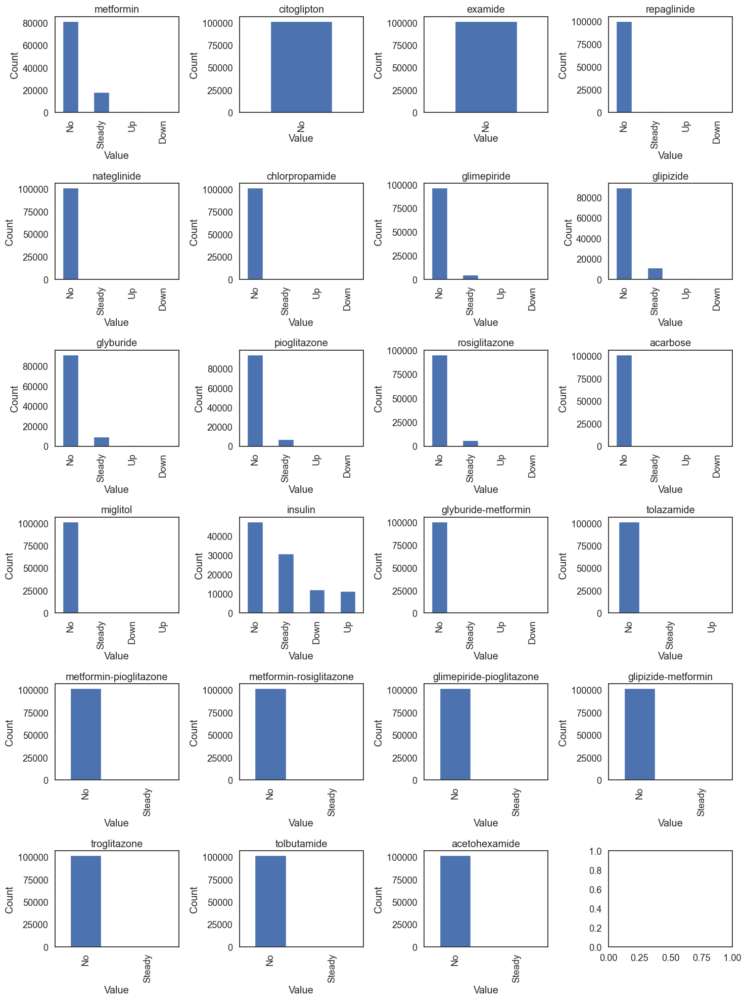

In [297]:
# Create a dictionary to store the count of different values in each column
med_counts = {}
for med in medications:
    med_counts[med] = diabetes[med].value_counts()
# Plot a bar chart for each medication column to show the count of different values
fig, axes = plt.subplots(nrows=6, ncols=4, figsize=(15, 20))
for i, ax in enumerate(axes.flat):
    if i < len(medications):
        med_counts[medications[i]].plot(kind='bar', ax=ax)
        ax.set_title(medications[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Count')
plt.tight_layout()
plt.show()

Common medication values were: 
* Steady - Stayed the same 
* Up - Increased 
* Down - Decreased 
* No - Does not take 

We decided to remove a 17 medication due to either having one value or rarley being use
* medications kept: 'insulin', 'metformin', 'glimepiride', 'glipizide', 'glyburide', 'pioglitazone'

In [358]:
datacopy = datacopy.drop(columns=['citoglipton', 'examide', 'repaglinide',
                                  'nateglinide', 'chlorpropamide',
                                  'acarbose', 'miglitol',  'rosiglitazone',  
                                  'glyburide-metformin', 'tolazamide', 
                                  'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
                                  'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide'])

In [361]:
print("After Cleaning Categorical Data")
print("================================")
print('No of encounters : {}\nNo of features : {}'.format(datacopy.shape[0],datacopy.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(datacopy.select_dtypes(exclude=object).shape[1],datacopy.select_dtypes(include=object).shape[1]))


After Cleaning Categorical Data
No of encounters : 99343
No of features : 28
Numerical features : 8 
Categorical features : 20


In [362]:
datacopy.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,None,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,None,No,No,No,No,No,Up,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),1,1,7,2,11,5,13,...,None,No,No,Steady,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),1,1,7,2,44,1,16,...,None,No,No,No,No,No,Up,Ch,Yes,NO
4,Caucasian,Male,[40-50),1,1,7,1,51,0,8,...,None,No,No,Steady,No,No,Steady,Ch,Yes,NO


## Numerical Features

In [325]:
numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_emergency', 'number_diagnoses', 'number_outpatient', 'number_inpatient']

In [193]:
diabetes2[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_emergency,number_diagnoses,number_outpatient,number_inpatient
count,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000
mean,4.379332,42.906929,1.334236,15.979062,0.198444,7.401709,0.369246,0.630935
std,2.968409,19.610032,1.702786,8.094909,0.937734,1.941013,1.265142,1.260428
min,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000
25%,2.000000,31.000000,0.000000,10.000000,0.000000,6.000000,0.000000,0.000000
50%,4.000000,44.000000,1.000000,15.000000,0.000000,8.000000,0.000000,0.000000
75%,6.000000,57.000000,2.000000,20.000000,0.000000,9.000000,0.000000,1.000000
max,14.000000,132.000000,6.000000,81.000000,76.000000,16.000000,42.000000,21.000000


Based on the mean/median scores:
* time in hospital - slight right skew (mean 4.4 & median = 4)
* num_lab_procedures - slight left skew (mean 42.9 & median = 44)
* num_procedures - slight right skew (mean = 1.3 & median = 1)
* num_medications - slight right skew (mean = 15.97 & median = 15)     
* number_emergency - High right skew (mean = 0.2 & median = 0)
    * Max value = 76 could mean we have outliers in out dataset
        * Alot of 0's in rows
* number_diagnoses - slight left skew (mean = 7.4 & median = 8)
* number_outpatient - High right skew (mean = 0.37 & median = 0)
    * Max value = 42 could mean we have outliers in out dataset
        * Alot of 0's in rows 
* number_inpatient -  High right skew (mean = 0.63 & median = 0)
    * Max value = 21 could mean we have outliers in out dataset
        * Alot of 0's in rows 

time_in_hospital       1.141853
num_lab_procedures    -0.241522
num_procedures         1.322209
num_medications        1.335408
number_emergency      22.848462
number_diagnoses      -0.861486
number_outpatient      8.839544
number_inpatient       3.633365
dtype: float64


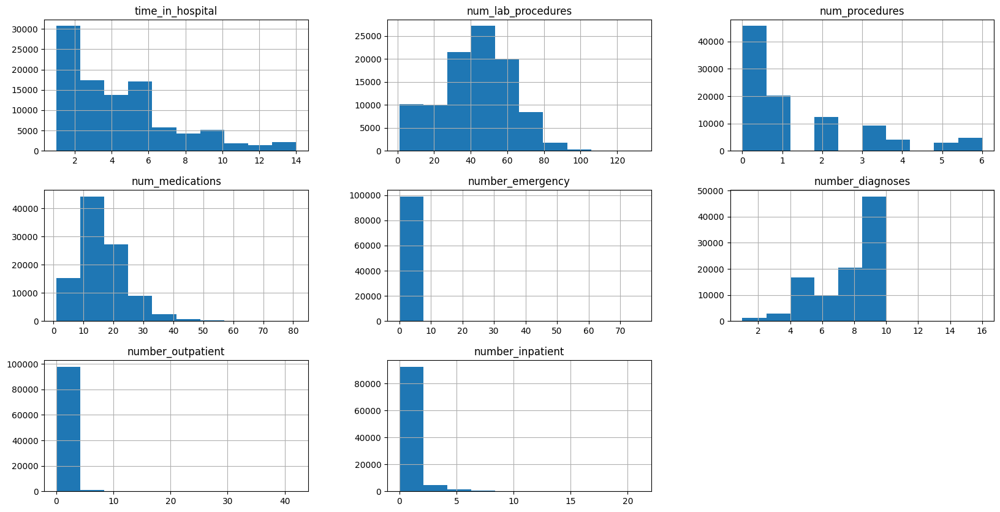

In [221]:
print(diabetes2[numerical].skew())
diabetes2[numerical].hist(figsize=(20,10));

What does this mean? 
* We have Skewed data that can affect:  
    * Accuracy and interpretability of the prediction model
        * May introduce bias
    * Will scale slight skews using Scaler() function from the sklearn package 
* Will need to perform a square root transformation on large skews:
    * Number of emergencys
    * Number inpatient
    * Number outpatients

During model building


## Bivariate Analysis: 


In [366]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

In [420]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["gender", "readmitted"]).size().reset_index(name="count")

# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["gender", "count"], ascending=[False, True])

# Create a stacked bar chart with gender on x-axis and readmitted as color
color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
fig = px.bar(readmitted_counts, x="gender", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)

# Set the height and width of the chart
fig.update_layout(width=600, height=400)

# Show the chart
fig.show()

# compute probabilities for female/male patients
female_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Female') & (diabetes2['readmitted'] == 'Readmitted')]['gender'].count() / diabetes2[diabetes2['gender'] == 'Female']['gender'].count()
male_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Male') & (diabetes2['readmitted'] == 'Readmitted')]['gender'].count() / diabetes2[diabetes2['gender'] == 'Male']['gender'].count()
# print out the results
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted within 30 days")

A Female has a probability of 11.46% to be readmitted within 30 days
A Male has a probability of 11.3% to be readmitted within 30 days


Not much of a difference for males vs females who readmitted
* Females slightly higher percentage by ~0.16% 

In [414]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["age", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["age", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color

color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
fig = px.bar(readmitted_counts, x="age", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
# Show the chart
fig.show()
# Print the results
prob_by_age = diabetes2.groupby("age")["readmitted"].value_counts(normalize=True) * 100
prob_by_age = prob_by_age.loc[:, 'Readmitted']
print(prob_by_age)

age
<30         11.224653
[40-50)     10.658895
[50-60)      9.771395
[60-70)     11.302022
[70-80)     12.057326
[80-90)     12.565413
[90-100)    11.896485
Name: readmitted, dtype: float64


* As age goes up readmissions also go up however, this also can be mainly due to the larger number of older patients in this sample

In [413]:
# Count the number of readmissions for each A1Cresult
readmitted_counts = diabetes2.groupby(["A1Cresult", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["A1Cresult", "count"], ascending=[False, True])

color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
# Create a stacked bar chart with A1Cresult on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="A1Cresult", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=500, height=600)
# Show the chart
fig.show()
prob_by_a1c = diabetes2.groupby("A1Cresult")["readmitted"].value_counts(normalize=True) * 100
prob_by_a1c = prob_by_a1c.loc[:, 'Readmitted']
print(prob_by_a1c)

# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["change", "readmitted"]).size().reset_index(name="count")
readmitted_counts2 = diabetes2.groupby(["diabetesMed", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["change", "count"], ascending=[False, True])
readmitted_counts2 = readmitted_counts2.sort_values(["diabetesMed", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="change", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
fig2 = px.bar(readmitted_counts2, x="diabetesMed", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
fig2.update_layout(width=600, height=400)
# Show the chart
fig.show()
fig2.show()

prob_by_change = diabetes2.groupby("change")["readmitted"].value_counts(normalize=True) * 100
prob_by_change = prob_by_change.loc[:, 'Readmitted']
print(prob_by_change)

prob_by_diabetesMed = diabetes2.groupby("diabetesMed")["readmitted"].value_counts(normalize=True) * 100
prob_by_diabetesMed = prob_by_diabetesMed.loc[:, 'Readmitted']
print(prob_by_diabetesMed)

A1Cresult
>7      10.145695
>8       9.942239
None    11.685211
Norm     9.772450
Name: readmitted, dtype: float64


change
Ch    12.022984
No    10.839910
Name: readmitted, dtype: float64
diabetesMed
No      9.870486
Yes    11.837011
Name: readmitted, dtype: float64


Taking a look at weather or not changes in medication have an effect on readmission rates and if those changes were towards diabetes medication: 
* patients who had a change in medications readmit 12% of the time in <30 days
* patients who have diabetes medication were found to readmit 12% of the time in <30 days
    * can also say that alot more people who had encounters had diabetes medication
* A1C variable may be biased towards the "None" category, which may indicate that it was not measured in some patients, it is still a clinically relevant and an important variable to use for our readmission model

## Testing Categorical and Numerical Features

### Correlation matrix

In [370]:
diabetes2.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,<30,6,25,1,1,41,0,1,...,None,No,No,No,No,No,No,No,No,Not Readmitted
1,Caucasian,Female,<30,1,1,7,3,59,0,18,...,None,No,No,No,No,No,Up,Ch,Yes,Not Readmitted
2,AfricanAmerican,Female,<30,1,1,7,2,11,5,13,...,None,No,No,Steady,No,No,No,No,Yes,Not Readmitted
3,Caucasian,Male,<30,1,1,7,2,44,1,16,...,None,No,No,No,No,No,Up,Ch,Yes,Not Readmitted
4,Caucasian,Male,[40-50),1,1,7,1,51,0,8,...,None,No,No,Steady,No,No,Steady,Ch,Yes,Not Readmitted


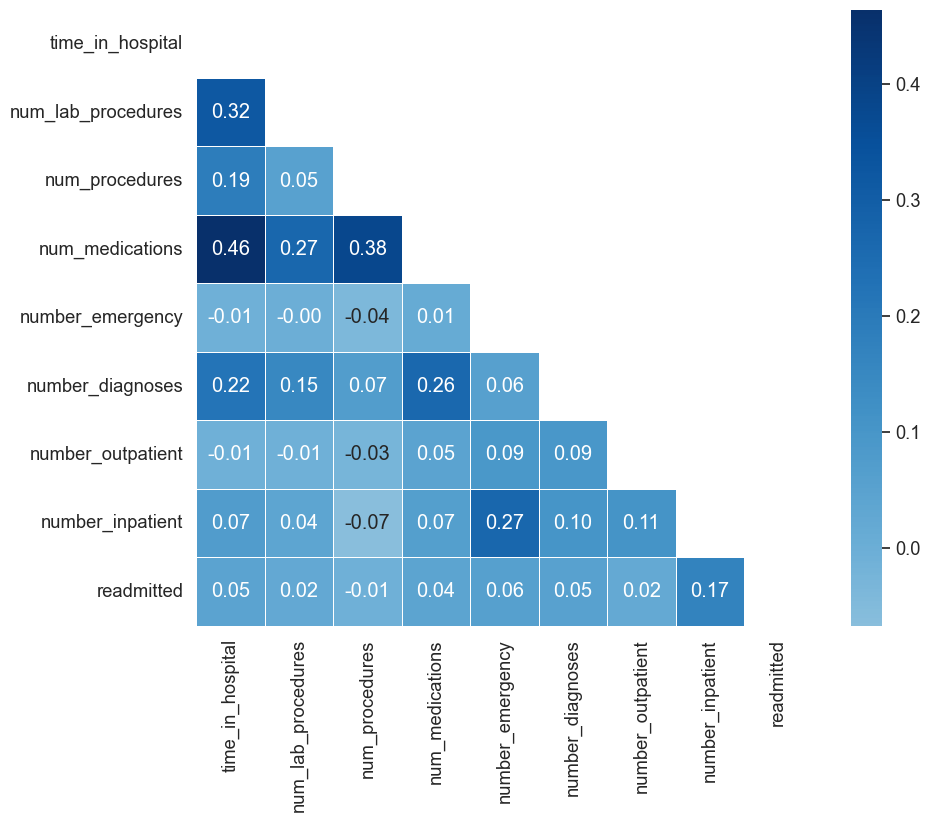

In [335]:
readmission_col = 'readmitted'
# Create a new dataframe with the numerical and readmission columns
numerical_df = diabetes2[numerical + [readmission_col]]

# Calculate the correlation matrix
corr_matrix = numerical_df.corr()

# Plot the correlation matrix using a heatmap
sns.set(font_scale=1.2)
sns.set_style("white")
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, mask=mask, annot=True, fmt=".2f", cmap='Blues', center=0, square=True, linewidths=0.5)
plt.show()

* Correlation matrix: 
    * Not much numerical variables correlate to readmitted columns
        * Imbalance dataset

### Mutual Info Score: 

* The degree of dependency between a categorical variable and the target variable can be measured by using a mutual info score
    * Higher values = higher degree of dependence

In [76]:
categorical = ['race', 'age', 'gender', 'admission_type_id', 'admission_source_id',
               'discharge_disposition_id',
               'diag_1', 'diag_2', 'diag_3', 
               'max_glu_serum', 'A1Cresult', 'insulin', 'metformin', 'repaglinide',
               'glimepiride', 'glipizide', 'glyburide', 'pioglitazone', 'rosiglitazone',
               'change', 'diabetesMed']

In [77]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes2['readmitted']) 

diabetes2_cat = diabetes2[categorical].apply(cat_mut_inf) 
diabetes2_cat = diabetes2_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetes2_cat

,mutual_info_score
discharge_disposition_id,0.005603
diag_3,0.001036
diag_1,0.001001
insulin,0.000973
diag_2,0.000744
metformin,0.000366
diabetesMed,0.000347
admission_source_id,0.000312
age,0.000296
A1Cresult,0.000221


* As seen above, most of the categorical variables have almost no effect on the target variable.
    * Remember we have an imbalance in our target varaible

## A little bit of cleaning before createing the ML model

In [412]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

Going to clean the dataset alittle bit more so it can fit the ML model better

In [379]:
# applywhying square root transformation on right skewed count data to reduce the effects of extreme values (0).
diabetes2['number_outpatient'] = diabetes2['number_outpatient'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_emergency'] = diabetes2['number_emergency'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_inpatient'] = diabetes2['number_inpatient'].apply(lambda x: np.sqrt(x + 0.5))

#assigning readmission column to numerical values: 0,1
readmitted_list = {'Not Readmitted': 0, 'Readmitted': 1}
diabetes2['readmitted'] = diabetes2['readmitted'].map(readmitted_list)

# Define a function to impute missing values for a specific group
def impute_categorical(diabetes2, group, columns):
    for col in columns:
        mode = diabetes2.loc[diabetes2['readmitted'] == group, col].mode()[0]
        diabetes2.loc[(diabetes2[col] == '?') | (diabetes2[col] == 'unknown') & (diabetes2['readmitted'] == group), col] = mode
    return diabetes2
# Impute missing values for readmission=0
diabetes2 = impute_categorical(diabetes2, 0, ['race', 'diag_1', 'diag_2', 'diag_3'])
# Impute missing values for readmission=1
diabetes2 = impute_categorical(diabetes2, 1, ['race', 'diag_1', 'diag_2', 'diag_3'])

One hot encoding for categorical data

In [380]:
cols_to_encode = ['race', 'age', 'gender', 
                  'admission_type_id', 'admission_source_id',
                  'discharge_disposition_id',
                  'diag_1', 'diag_2', 'diag_3', 
                  'max_glu_serum', 'A1Cresult', 
                  'insulin', 'metformin','glimepiride', 
                  'glipizide', 'glyburide', 
                  'pioglitazone',
                  'change', 'diabetesMed']

# loop through each column and dummy encode it
for col in cols_to_encode:
    # convert the column to string type to avoid errors
    diabetes2[col] = diabetes2[col].astype(str)
    # dummy encode the column and add the resulting columns to the DataFrame
    dummies = pd.get_dummies(diabetes2[col], prefix=col)
    diabetes2 = pd.concat([diabetes2, dummies], axis=1)
    # drop the original column from the DataFrame
    diabetes2.drop(col, axis=1, inplace=True)
    

In [381]:
diabetes2.head(2)

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,readmitted,race_AfricanAmerican,...,glyburide_Steady,glyburide_Up,pioglitazone_Down,pioglitazone_No,pioglitazone_Steady,pioglitazone_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,1,41,0,1,0.707107,0.707107,0.707107,1,0,0,...,0,0,0,1,0,0,0,1,1,0
1,3,59,0,18,0.707107,0.707107,0.707107,9,0,0,...,0,0,0,1,0,0,1,0,0,1


In [382]:
diabetes2.to_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav3.csv')

# Breaking the data up into Train & Test

In [384]:
diabetes3 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav3.csv')
diabetes3 = diabetes3.iloc[:, 1:]

In [385]:
train_df, valid_df, test_df = np.split(diabetes3.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetes3)), int(0.85*len(diabetes3))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [386]:
diabetes2.readmitted.value_counts()

0    88026
1    11314
Name: readmitted, dtype: int64

In [387]:
train_df.readmitted.value_counts()

0    61622
1     7916
Name: readmitted, dtype: int64

In [388]:
valid_df.readmitted.value_counts()

0    13194
1     1707
Name: readmitted, dtype: int64

In [389]:
test_df.readmitted.value_counts()

0    13210
1     1691
Name: readmitted, dtype: int64

Why did we break the dataset into 3 different sets? 
* Training set: 
    * Trains the model on the available data 
        * should not be used to evaluate the different models performance
* Validation set (MOST IMPORANT ONE FOR US): 
    * Used to tune the models Hyperparementers and select the best features 
* Testing set: 
    * used to evaulate the models performance on unseen data 
        * for future use evaluation

In [390]:
def calc_prevalence(y_actual):
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    Params:
    1. y_actual: The target feature
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    return (sum(y_actual)/len(y_actual))

In [391]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
diabetes_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# shuffle the order of training samples 
diabetes_df_balanced = diabetes_df_balanced.sample(n = len(diabetes_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(diabetes_df_balanced), \
                                                calc_prevalence(diabetes_df_balanced.readmitted.values)))

Train balanced prevalence(n = 15832):0.500


In [392]:
diabetes_df_balanced.readmitted.value_counts()

0    7916
1    7916
Name: readmitted, dtype: int64

In [393]:
X_train = diabetes_df_balanced.drop('readmitted',axis=1)

y_train = diabetes_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [394]:
# scaling our numerical values to fit the model
scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient'])

In [395]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual == 0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

In [396]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [397]:
y_valid_preds

array([0.6223526 , 0.40300941, 1.03984451, ..., 0.5561676 , 0.79071045,
       0.38350868])

In [398]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.667
accuracy:0.664
recall:0.553
precision:0.182
specificity:0.678
prevalence:0.115
 


In [399]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.653
accuracy:0.667
recall:0.513
precision:0.175
specificity:0.655
prevalence:0.115
 


In [400]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.657
accuracy:0.610
recall:0.610
precision:0.168
specificity:0.610
prevalence:0.115
 


In [401]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.619
accuracy:0.565
recall:0.624
precision:0.154
specificity:0.555
prevalence:0.115
 


In [402]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.665
accuracy:0.610
recall:0.621
precision:0.170
specificity:0.609
prevalence:0.115
 


In [403]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.667
accuracy:0.872
recall:0.114
precision:0.327
specificity:0.970
prevalence:0.115
 


In [404]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.633
accuracy:0.607
recall:0.593
precision:0.164
specificity:0.609
prevalence:0.115
 


In [405]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

0:	learn: 0.6635647	total: 5.67ms	remaining: 1.13s
1:	learn: 0.6563600	total: 11.4ms	remaining: 1.13s
2:	learn: 0.6550663	total: 16.4ms	remaining: 1.08s
3:	learn: 0.6538906	total: 22.3ms	remaining: 1.09s
4:	learn: 0.6525853	total: 28.1ms	remaining: 1.09s
5:	learn: 0.6500675	total: 32.9ms	remaining: 1.06s
6:	learn: 0.6493537	total: 38.7ms	remaining: 1.07s
7:	learn: 0.6477395	total: 43.5ms	remaining: 1.04s
8:	learn: 0.6464181	total: 48.1ms	remaining: 1.02s
9:	learn: 0.6453365	total: 53.9ms	remaining: 1.02s
10:	learn: 0.6441298	total: 58.8ms	remaining: 1.01s
11:	learn: 0.6429192	total: 64.5ms	remaining: 1.01s
12:	learn: 0.6417786	total: 69.1ms	remaining: 993ms
13:	learn: 0.6404608	total: 74.6ms	remaining: 991ms
14:	learn: 0.6394802	total: 80.1ms	remaining: 988ms
15:	learn: 0.6382147	total: 85.4ms	remaining: 982ms
16:	learn: 0.6376000	total: 90.9ms	remaining: 979ms
17:	learn: 0.6367934	total: 95.4ms	remaining: 964ms
18:	learn: 0.6357652	total: 101ms	remaining: 961ms
19:	learn: 0.6350565	to

In [406]:
recall_scoring = make_scorer(recall_score)

# Decision Tree Hyperparameter

In [407]:
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.54885060303724

In [408]:
recall_score(y_valid, dc_hp_preds)

0.7973052138254247

## Random Forest Hyperparamter

In [409]:
rf_grid = {'n_estimators':range(200,1000,200), # number of trees
           'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

rf_random = RandomizedSearchCV(estimator = rf_clf, param_distributions = rf_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

rf_random.fit(X_train, y_train)

rf_random.best_params_

rf_hp_preds = rf_random.best_estimator_.predict(X_valid)
rf_hp_preds_proba = rf_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, rf_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.670103193486166

In [410]:
recall_score(y_valid, rf_hp_preds)

0.6303456356180434

## Using Random Forest to Find Best Variables

Top 10 features are: 
num_lab_procedures
num_medications
time_in_hospital
number_inpatient
num_procedures
number_diagnoses
number_outpatient
number_emergency
diag_2_circulatory
diag_3_circulatory


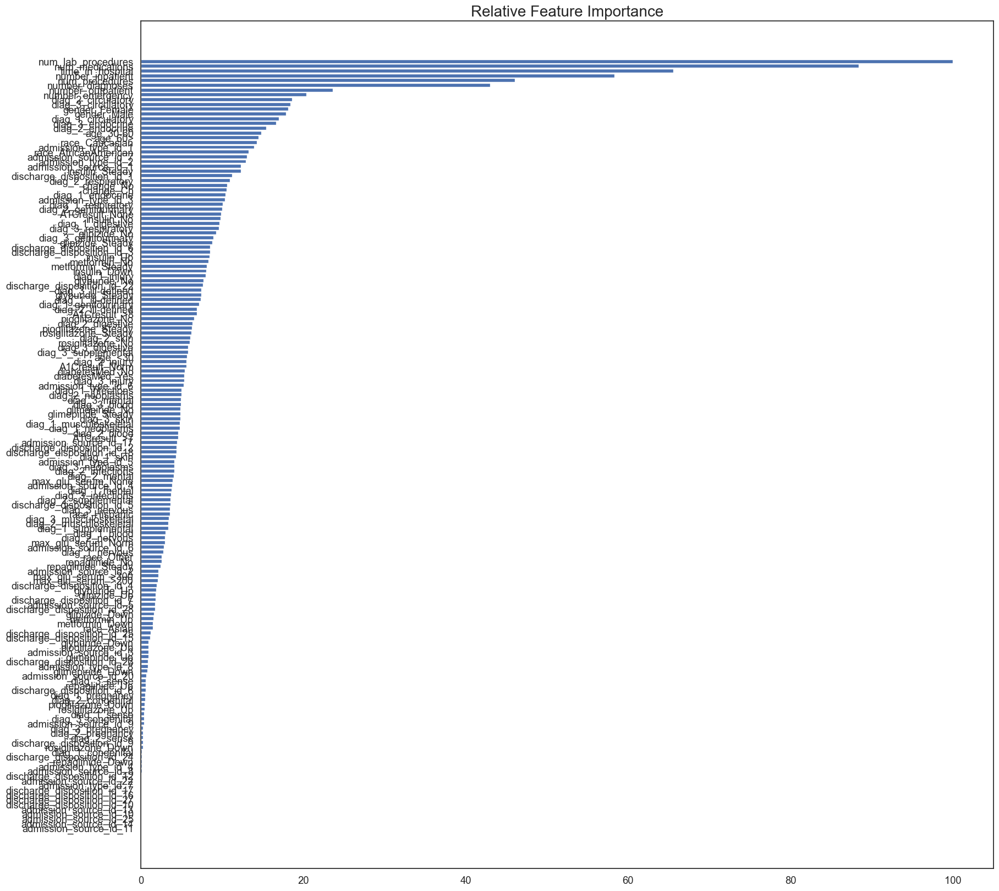

In [293]:
# create X (features) and y (response)
X = diabetes3.drop(['readmitted'], axis=1)
y = diabetes3['readmitted']
X_cv, X_test, y_cv, y_test = train_test_split(X, y, test_size=0.3)
# fit Random Forest model to the cross-validation data
from sklearn.ensemble import RandomForestClassifier
forest = RandomForestClassifier()
forest.fit(X_cv, y_cv)
importances = forest.feature_importances_
# make importance relative to the max importance
feature_importance = 100.0 * (importances / importances.max())
sorted_idx = np.argsort(feature_importance)
feature_names = list(X_cv.columns.values)
feature_names_sort = [feature_names[indice] for indice in sorted_idx]
pos = np.arange(sorted_idx.shape[0]) + .5
print('Top 10 features are: ')
for feature in feature_names_sort[::-1][:10]:
    print(feature)
# plot the result
plt.figure(figsize=(20, 20))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, feature_names_sort)
plt.title('Relative Feature Importance', fontsize=20)
plt.show()